<a href="https://colab.research.google.com/github/parkmicheal1114/study/blob/main/Kaggele/Credit_Card_Fraud_kaggle.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

https://www.kaggle.com/code/ohseokkim/creditcard-fraud-balance-is-key-feat-pycaret

- kaggle 필사 스터디로 위 링크를 참조하여 작성 하였습니다. 
- 주제 : Credit Card Fraud 
- 신용카드사기를 탐지 하는 분류.
- 학습을 위해서 주석 과 링크 까지 같이 번역하여 진행 하였습니다.


**오버샘플링 및 언더샘플링**

> 오버샘플링과 언더샘플링 모두 데이터에 이미 존재하거나 순수 무작위 샘플을 추출할 경우 발생할 수 있는 불균형을 보완하기 위해 한 클래스에서 다른 클래스보다 더 많은 샘플을 선택하는 편향을 도입하는 것을 포함합니다. 데이터 불균형에는 다음과 같은 유형이 있습니다:

> 1. 하나 이상의 중요한 예측 변수에서 클래스가 과소 대표되는 경우. 성 차별 문제를 다루기 위해 컴퓨터 소프트웨어와 같은 특정 분야의 급여에 대한 설문조사 데이터가 있다고 가정해 보겠습니다. 소프트웨어 엔지니어의 무작위 표본에서 여성이 상당히 과소 대표되는 것으로 알려져 있으며, 이는 재직 기간 및 현재 연차 수준과 같은 다른 변수를 조정할 때 중요할 것입니다. 소프트웨어 엔지니어의 20%만이 여성이고, 즉 남성이 여성보다 4배 더 많다고 가정해 보겠습니다. 데이터를 수집하기 위해 설문조사를 설계한다면, 최종 표본에서 두 성별이 동등하게 대표되도록 남성보다 4배 더 많은 여성을 대상으로 설문조사를 실시할 것입니다. (계층화 샘플링 참조).
> 2. 결과(종속) 변수에서 한 계층이 과소 대표되는 경우. 대규모 임상 데이터 집합에서 어떤 환자가 특정 질병(예: 당뇨병)에 걸릴 가능성이 높은지 예측하고자 한다고 가정해 보겠습니다. 그러나 환자의 10%만이 해당 질병에 걸린다고 가정해 봅시다. 기존의 대규모 데이터 세트가 있다고 가정합니다. 그러면 질병에 걸린 환자 1명당 질병에 걸리지 않은 환자 수를 9배로 뽑을 수 있습니다.

> 오버샘플링은 일반적으로 언더샘플링보다 더 자주 사용되며, 특히 설문조사, 인터뷰 등을 통해 세부 데이터를 아직 수집하지 않은 경우 더욱 그렇습니다. 언더샘플링은 훨씬 덜 자주 사용됩니다. 이미 수집된 데이터의 과잉은 '빅 데이터' 시대에 와서야 문제가 되었으며, 언더샘플링을 사용하는 이유는 주로 리소스 비용과 관련된 실용적인 이유입니다. 특히, 유효한 통계적 결론을 도출하기 위해서는 적절하게 큰 표본 크기가 필요하지만, 데이터를 사용하기 전에 데이터를 정리해야 합니다. 정리에는 일반적으로 상당한 인적 요소가 포함되며, 일반적으로 데이터 집합과 분석 문제에 따라 달라지므로 시간과 비용이 소요됩니다. 

> 예를 들어
> 1. 도메인 전문가는 변수 내 검사(허용 가능한 값, 가능한 최대 및 최소 유효 값 등)뿐만 아니라 변수 간 검사도 포함하는 데이터 세트별 유효성 검사 방법을 제안합니다. 예를 들어, 차등 백혈구 수의 개별 구성 요소는 각각 전체의 백분율이기 때문에 모두 합산하여 100이 되어야 합니다.
> 2. 내러티브 텍스트에 포함된 데이터(예: 인터뷰 녹취록)는 통계 또는 머신러닝 패키지가 처리할 수 있는 불연속형 변수로 수동 코딩해야 합니다. 데이터가 많을수록 코딩 작업도 많아집니다. (때로는 소프트웨어를 통해 코딩을 수행할 수도 있지만, 이를 위해서는 누군가가 맞춤형 일회성 프로그램을 작성해야 하는 경우가 많으며, 프로그램 출력의 정확성(오탐 및 미탐 결과)을 테스트해야 합니다. 이러한 이유로 일반적으로 합리적인 통계적 신뢰도(표본 크기 참조)를 가지고 질문에 답하는 데 필요한 만큼의 데이터만 정제하며, 그 이상은 정제하지 않습니다.


> 이진 분류의 경우 타겟 값이 한쪽으로 치우치는 경우가 발생할 수 있습니다. 따라서 EDA 과정에서 목표 값의 분포를 확인할 필요가 있습니다.

> 이 노트에서는 오버샘플링과 언더샘플링 후 데이터 분포가 어떻게 변화하는지, 이를 통해 불균형을 효과적으로 해소할 수 있는지 살펴봅니다. 마지막으로 28차원 데이터셋을 2차원으로 축소하는 그림을 그려봅니다. 데이터셋이 그려낸 아름다운 그림이 있습니다.

> 그 후 적절한 샘플링 방법을 사용하여 샘플링 후 분류 문제를 해결해봅니다.


# Setting Up

In [87]:
# colab 에서  pycaret 설치.
!pip install --pre pycaret
!pip install umap-learn
!pip install umap-learn[plot]
!pip install umap-learn[parametric_umap]

import umap
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
from sklearn.model_selection import train_test_split
from plotly.subplots import make_subplots
import plotly.graph_objects as go
%matplotlib inline

import warnings
warnings.filterwarnings('ignore')

import umap #차원 축소 알고리즘
import umap.plot
from pycaret.classification import * # pycaret 
from sklearn.metrics import accuracy_score , precision_score , recall_score , roc_auc_score
from sklearn.metrics import f1_score , confusion_matrix , precision_recall_curve , roc_curve
from sklearn.metrics import ConfusionMatrixDisplay

import scipy.stats as stats



Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


 - UMAP
  - https://data-newbie.tistory.com/169
 - Pycaret
  - AutoML

# Checking Target imbalance

In [88]:
df_cfd = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/study_dataset/creditcard.csv/creditcard.csv')
df_raw = df_cfd.copy()

In [89]:
# Fraud , Normal 거래 비율 시각화 
color = ['gold', 'mediumturquoise']
label = ['Noraml' , 'Fraud']
values = df_cfd['Class'].value_counts()/df_cfd['Class'].shape[0]

fig = go.Figure(data = [go.Pie(labels= label,
                              values= values,
                              hole = .3)])

fig.update_traces(hoverinfo='label+percent', textinfo = 'percent',
                  textfont_size = 20 , marker = dict(colors=color , line=dict(color='white',width=0.)))

fig.update_layout(
    title_text="Credit Card Fraud",
    title_font_color="white",
    legend_title_font_color="yellow",
    paper_bgcolor="black",
    plot_bgcolor='black',
    font_color="white",
)
fig.show()

Observation:

- 데이터 셋에서 Normal 과 Fraud 에 대한 클래스 불균형이 확인 된다. 

- 이를 해소 하기 위해서 오버샘플링 혹은 언더샘플링 을 고려할 것이다.

# EDA

In [90]:
df_cfd.head(5).T

,0,1,2,3,4
Time,0.000000,0.000000,1.000000,1.000000,2.000000
V1,-1.359807,1.191857,-1.358354,-0.966272,-1.158233
V2,-0.072781,0.266151,-1.340163,-0.185226,0.877737
V3,2.536347,0.166480,1.773209,1.792993,1.548718
V4,1.378155,0.448154,0.379780,-0.863291,0.403034
V5,-0.338321,0.060018,-0.503198,-0.010309,-0.407193
V6,0.462388,-0.082361,1.800499,1.247203,0.095921
V7,0.239599,-0.078803,0.791461,0.237609,0.592941
V8,0.098698,0.085102,0.247676,0.377436,-0.270533
V9,0.363787,-0.255425,-1.514654,-1.387024,0.817739


In [91]:
df_cfd.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 284807 entries, 0 to 284806
Data columns (total 31 columns):
 #   Column  Non-Null Count   Dtype  
---  ------  --------------   -----  
 0   Time    284807 non-null  float64
 1   V1      284807 non-null  float64
 2   V2      284807 non-null  float64
 3   V3      284807 non-null  float64
 4   V4      284807 non-null  float64
 5   V5      284807 non-null  float64
 6   V6      284807 non-null  float64
 7   V7      284807 non-null  float64
 8   V8      284807 non-null  float64
 9   V9      284807 non-null  float64
 10  V10     284807 non-null  float64
 11  V11     284807 non-null  float64
 12  V12     284807 non-null  float64
 13  V13     284807 non-null  float64
 14  V14     284807 non-null  float64
 15  V15     284807 non-null  float64
 16  V16     284807 non-null  float64
 17  V17     284807 non-null  float64
 18  V18     284807 non-null  float64
 19  V19     284807 non-null  float64
 20  V20     284807 non-null  float64
 21  V21     28

In [92]:
df_cfd.describe()

,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,...,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
count,284807.000000,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,...,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,284807.000000,284807.000000
mean,94813.859575,1.168375e-15,3.416908e-16,-1.379537e-15,2.074095e-15,9.604066e-16,1.487313e-15,-5.556467e-16,1.213481e-16,-2.406331e-15,...,1.654067e-16,-3.568593e-16,2.578648e-16,4.473266e-15,5.340915e-16,1.683437e-15,-3.660091e-16,-1.227390e-16,88.349619,0.001727
std,47488.145955,1.958696e+00,1.651309e+00,1.516255e+00,1.415869e+00,1.380247e+00,1.332271e+00,1.237094e+00,1.194353e+00,1.098632e+00,...,7.345240e-01,7.257016e-01,6.244603e-01,6.056471e-01,5.212781e-01,4.822270e-01,4.036325e-01,3.300833e-01,250.120109,0.041527
min,0.000000,-5.640751e+01,-7.271573e+01,-4.832559e+01,-5.683171e+00,-1.137433e+02,-2.616051e+01,-4.355724e+01,-7.321672e+01,-1.343407e+01,...,-3.483038e+01,-1.093314e+01,-4.480774e+01,-2.836627e+00,-1.029540e+01,-2.604551e+00,-2.256568e+01,-1.543008e+01,0.000000,0.000000
25%,54201.500000,-9.203734e-01,-5.985499e-01,-8.903648e-01,-8.486401e-01,-6.915971e-01,-7.682956e-01,-5.540759e-01,-2.086297e-01,-6.430976e-01,...,-2.283949e-01,-5.423504e-01,-1.618463e-01,-3.545861e-01,-3.171451e-01,-3.269839e-01,-7.083953e-02,-5.295979e-02,5.600000,0.000000
50%,84692.000000,1.810880e-02,6.548556e-02,1.798463e-01,-1.984653e-02,-5.433583e-02,-2.741871e-01,4.010308e-02,2.235804e-02,-5.142873e-02,...,-2.945017e-02,6.781943e-03,-1.119293e-02,4.097606e-02,1.659350e-02,-5.213911e-02,1.342146e-03,1.124383e-02,22.000000,0.000000
75%,139320.500000,1.315642e+00,8.037239e-01,1.027196e+00,7.433413e-01,6.119264e-01,3.985649e-01,5.704361e-01,3.273459e-01,5.971390e-01,...,1.863772e-01,5.285536e-01,1.476421e-01,4.395266e-01,3.507156e-01,2.409522e-01,9.104512e-02,7.827995e-02,77.165000,0.000000
max,172792.000000,2.454930e+00,2.205773e+01,9.382558e+00,1.687534e+01,3.480167e+01,7.330163e+01,1.205895e+02,2.000721e+01,1.559499e+01,...,2.720284e+01,1.050309e+01,2.252841e+01,4.584549e+00,7.519589e+00,3.517346e+00,3.161220e+01,3.384781e+01,25691.160000,1.000000


<Axes: >

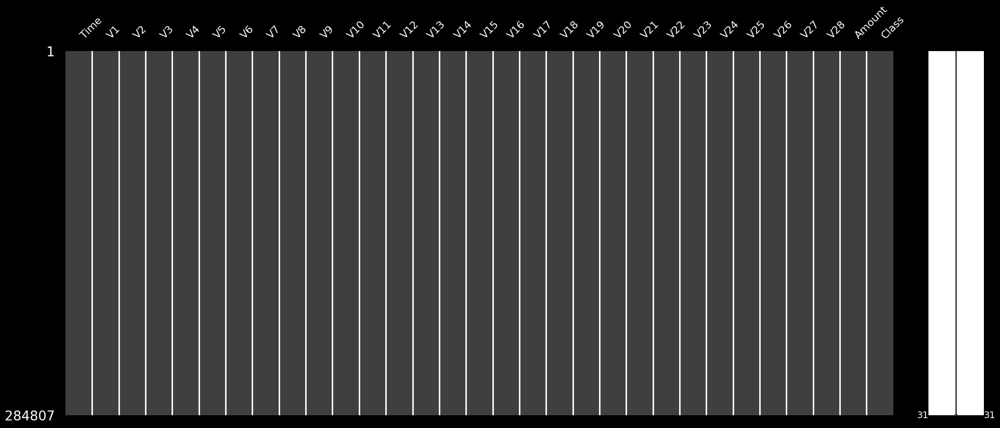

In [93]:
import missingno as msno
msno.matrix(df_cfd)

 - Observation
  - 결측치는 없는 것으로 확인 된다.

# Checking the data type of features

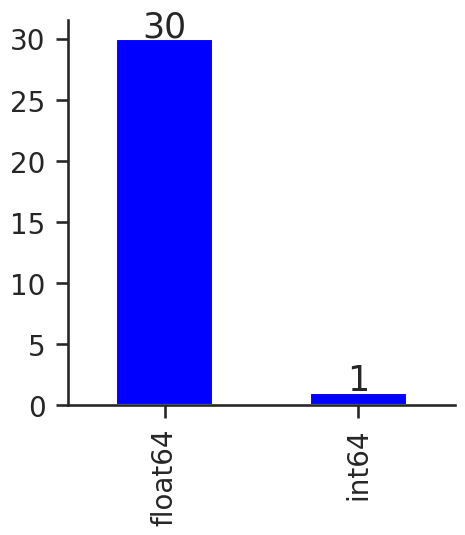

In [94]:
# data type 확인.
sns.set(style = 'ticks' , context='talk',font_scale = 1)

plt.figure(figsize=(5,5))

ax = df_cfd.dtypes.value_counts().plot(kind='bar', grid = False , fontsize=20 , color='Blue')

for i in ax.patches:
  height  = i.get_height()
  ax.text(i.get_x()+i.get_width()/2 , height+0.2 ,height , ha='center',size = 25)

sns.despine()


Observation:

 - 모든 features 는 numeric 이다.

In [95]:
# 샘플 추출
df_cfd = df_cfd.sample(n=50000 , random_state=42)

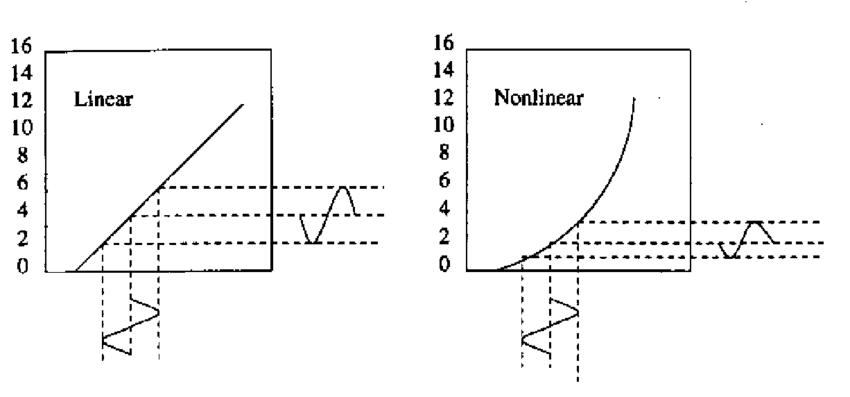

- 위에서 확인했듯이 모든 feature 는 수치형 입니다. 따라서 스케일링이 필요한지 확인하겠습니다. 
- 트리 기반 모델을 사용할 것이므로 선형 스케일링은 고려하지 않겠습니다.

* 스케일링에 대해 더 자세히 알고 싶으시다면 아래 노트북을 참고하시기 바랍니다.

- https://www.kaggle.com/code/ohseokkim/linear-nonlinear-scaling/notebook


In [96]:
df_cfd['Amount'].min()

0.0

In [97]:
numeric_cols = [col for col in df_cfd.loc[:,:'Amount'].columns if 
                df_cfd[col].min() >=0 and df_cfd[col].dtype in ['int64','float64']]


 - 다양한 피처에서 1보다 큰 skewness 는 왜곡된 것으로 판단되며 , 이러한 피처에만 비선형 스케일링이 적용됩니다.

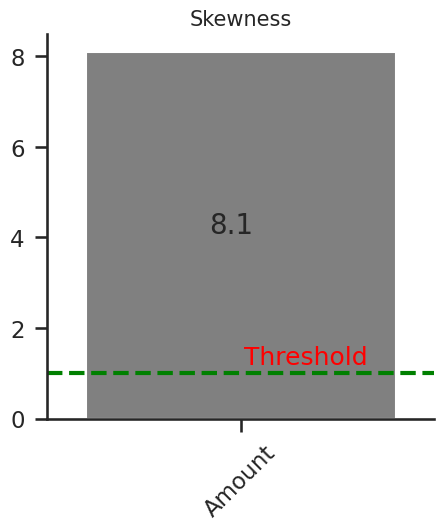

In [98]:
# feature 의 skewness 확인 
from scipy.stats import skew

plt.figure(figsize=(5,5))
skw_feature = df_cfd[numeric_cols].apply(lambda x : skew(x))
skw_feature = skw_feature[skw_feature > 0.5].sort_values(ascending=False)
ax = sns.barplot( x = skw_feature.index , y= skw_feature.values , color='grey')

for p in ax.patches:
  height  = p.get_height().round(1)
  ax.text(p.get_x()+p.get_width()/2.5 , height-4 ,height , ha='left',size = 20) 

plt.xticks(rotation=45)
plt.text(0.01,1.2, 'Threshold',color='red')
plt.axhline(y=1, color='green', linestyle='--', linewidth=3)
plt.title('Skewness',fontsize=15)
sns.despine()

Observation:

- Amount 만 조건을 충족합니다.(skew 가 1보다 크며, 비선형 스케일을 적용 한다는 얘기 인듯 함 )

 - Amount 의 분포를 확인 해 보자.

In [99]:
def check_nomality(feature):
  plt.figure(figsize=(5,5))
  ax1 = plt.subplot(1,1,1)
  stats.probplot(df_cfd[feature],dist = stats.norm , plot = ax1)
  ax1.set_title(f'{feature} Q-Q plot',fontsize = 10)
  sns.despine()

  mean = df_cfd['Amount'].mean()
  std = df_cfd['Amount'].std()
  skw = df_cfd['Amount'].skew()
  print(f'{feature} : mean : {mean: .4f}, std: {std: .4f} ,skw: {skw: .4f}')


In [100]:
def plot_hist(feature):
    fig = px.histogram(df_cfd, x=feature, 
                       color="Class",
                       marginal="box",
                       barmode ="overlay",
                       histnorm ='density'
                      )  
    fig.update_layout(
        title_text=f"{feature} Distribution",
        title_font_color="white",
        legend_title_font_color="yellow",
        paper_bgcolor="black",
        plot_bgcolor='black',
        font_color="white",
    )
    fig.show()

Amount : mean :  87.3777, std:  223.9379 ,skw:  8.0941


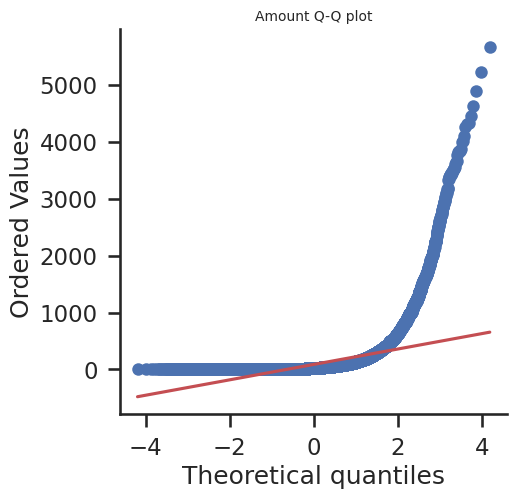

In [101]:
plot_hist('Amount')
check_nomality('Amount')

Observation:

- We can see that it is skewed as shown in the pictures above.

- 왜도 첨도 관련 추가 내용.
 - https://m.blog.naver.com/discoveringjmp/221998294906

# Doing Logarithm Scaling

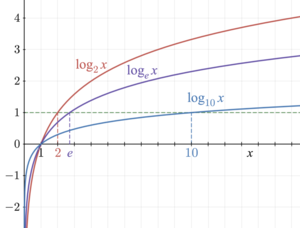

- 로그 함수는 작은 숫자 사이의 간격을 늘리고 큰 숫자 사이의 간격을 줄입니다. 
- 특정 특징에 작은 값의 값이 밀집되어 있는 경우, 이러한 간격을 늘리면 모델이 작은 값의 간격을 늘려서 이러한 값을 사용하여 학습 및 테스트할 때 모델의 성능을 향상시킬 수 있습니다.


In [102]:
df_cfd[skw_feature.index] =  np.log1p(df_cfd[skw_feature.index])

Amount : mean :  3.1557, std:  1.6545 ,skw:  0.1521


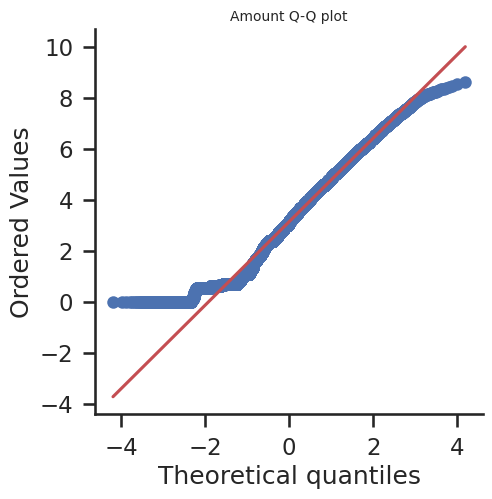

In [103]:
plot_hist("Amount")
check_nomality("Amount")

Observation:

- log scaling 을 통해서 skewness 가 개선 되었음을 볼 수 있다.

# Checking Correlations
- First, 히트맵을 그려서 클래스와 관련된 특성을 찾아 보도록 하자.

In [104]:
# heatmap
plt.figure(figsize=(20,20))
corr = df_cfd.corr().round(1)
fig = px.imshow(corr)
fig.update_layout(
    title_text = "Credit Card Fraud",
    title_font_color = 'black',
    legend_title_font_color='yellow',
)
fig.show()

<Figure size 2000x2000 with 0 Axes>

Observation:

- V3, V7, V10, V11, V12, V14, V16, and V17 는 class 와 강한 상관 관계를 가진다.

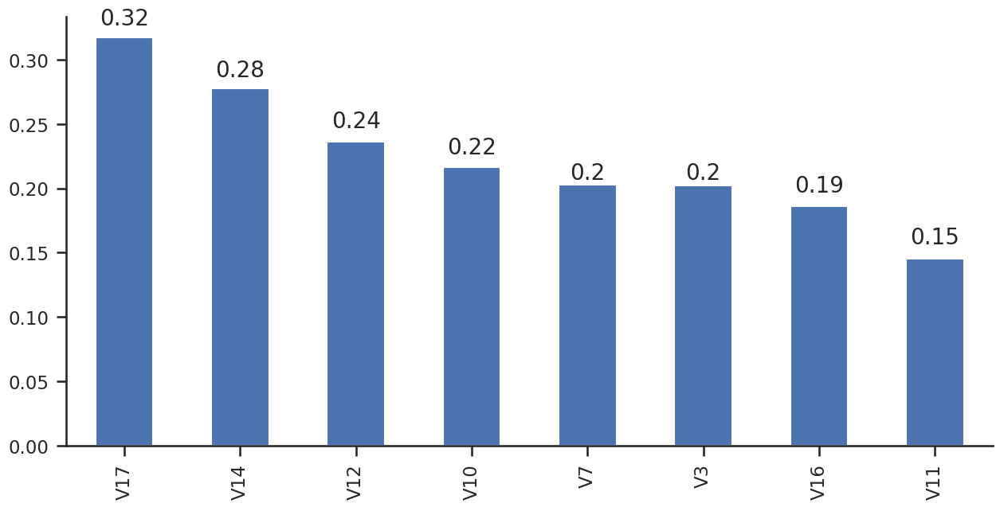

In [105]:
# class 와 상관계수 확인
features = ['V3', 'V7', 'V10', 'V11', 'V12', 'V14', 'V16', 'V17' ]

plt.figure(figsize=(15,7))
ax = abs(df_cfd[features].corrwith(df_cfd.Class)).sort_values(ascending=False).plot(kind='bar')
for p in ax.patches:
  height  = p.get_height().round(2)
  ax.text(p.get_x()+p.get_width()/2 , height+0.007 ,height , ha='center',size = 20)

sns.despine()

Observation:

- 위의 그림을 보면 V14 및 V17는 타겟 클래스와 높은 상관 관계를 보입니다. 이 feaure 에 대해 좀 더 자세히 살펴보겠습니다.

- V14와 V17 피처는 다른 feature 에 비해 클래스와의 상관관계가 높은 것으로 보입니다. 이 두 특징의 산점도를 통해 샘플링 전과 후의 차이를 분석해 보겠습니다

# Splitting train and test dataset


In [106]:
# 데이터셋 준비 , 불필요한 컬럼 제거 
def get_preprocessed_df(df=None):
  df_copy = df.copy()
  df_copy.drop('Time',axis = 1 ,inplace =True)
  return df_copy

In [107]:
# train ,test셋 분리 
# stratify 옵션으로 클래스 분포 비율 조정
def get_train_test_dataset(df=None):
  df_copy = get_preprocessed_df(df)
  X = df_copy.loc[:,:'Amount']
  y = df_copy.iloc[:,-1]
  X_train , X_test , y_train , y_test = train_test_split(X,y,test_size=0.3,random_state=0,stratify=y)
  return X_train , X_test , y_train , y_test

In [108]:
X_train , X_test , y_train , y_test = get_train_test_dataset(df_cfd)

# Checking Orignal Dataset


- Plotting histogram Plot


In [109]:
fig = px.histogram(df_cfd , x='V14',
                   color = 'Class',
                   marginal = 'box',
                   barmode ='overlay',
                   histnorm = 'density')

fig.update_layout(
    title_text = "Original Distribution",
    title_font_color = 'black',
    legend_title_font_color = 'black'
)

fig.show()

Observation:

- 불균형 상태도 큰 것 같습니다. 이 문제를 어떻게 해결할 수 있을지 생각해 봅시다.

Plotting Scatter Plot

In [110]:
color = ['gold','mediumturquoise']
fig = px.scatter(df_cfd , x = 'V17' , y='V14' , color = 'Class')

fig.update_layout(
    title_text = "Original Distribution",
    title_font_color = 'white',
    legend_title_font_color = 'yellow',
    paper_bgcolor="black",
    plot_bgcolor='black',
    font_color="white",
)

Visualizing after Dimension Reduction

- UMAP 
 - 차원축소 비교 ( PCA , t-SNe , UMAP )
 - https://velog.io/@stella_y/%EC%B0%A8%EC%9B%90-%EC%B6%95%EC%86%8C-%EC%95%8C%EA%B3%A0%EB%A6%AC%EC%A6%98%EC%9D%84-%EB%B9%84%EA%B5%90%ED%95%B4%EB%B3%B4%EC%9E%90-PCA-T-sne-UMAP

 - UMAP 정리
 - https://m.blog.naver.com/myohyun/222421460444



<Axes: >

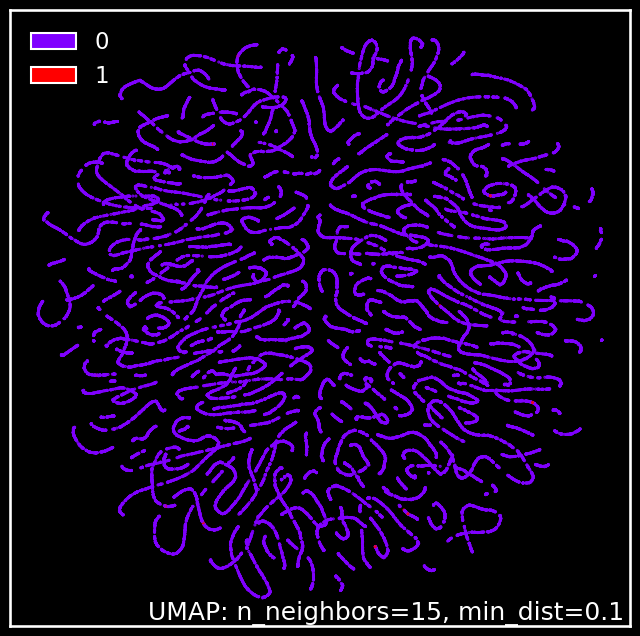

In [111]:
# UMPA 적용 , 시각화 .
sns.set(style='ticks',context = 'talk' , font_scale =1)
plt.style.use('dark_background')
mapper = umap.UMAP().fit(df_cfd.loc[:,:'Amount'])
umap.plot.points(mapper, labels=df_cfd.loc[:,'Class'] , theme='fire')

Observation:

- Wow! It is beatiful!
- target의 불균형이 심합니다. Fraud 가 Normal 에 비해서 매우 작은 편입니다.

- 클래스 불균형 문제 정의 
  - https://gils-lab.tistory.com/2

# Oversampling

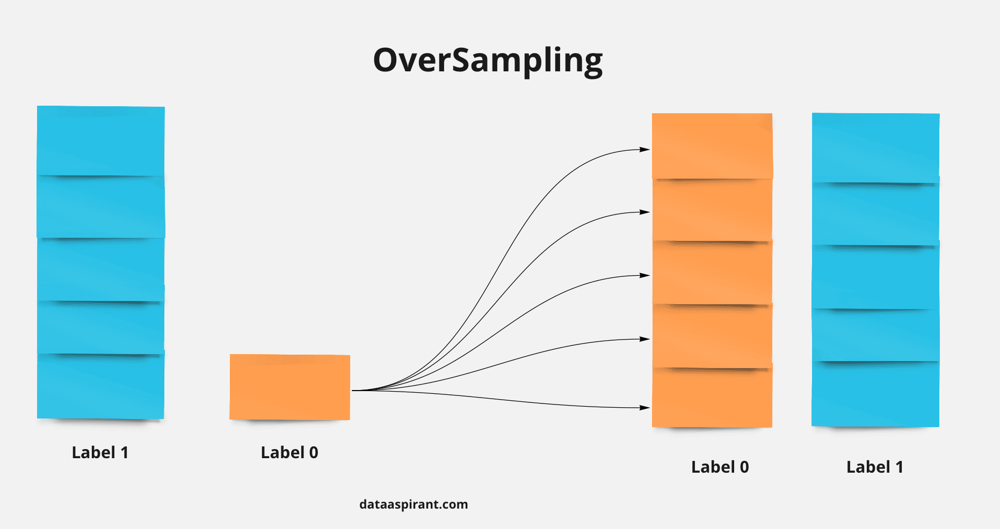

- imbalanced data 처리를 위한 sampling 기법
 - https://casa-de-feel.tistory.com/15
- SMOTE 설명
 - http://www.incodom.kr/SMOTE
 

각 방법을 사용하여 V14 feature을 오버샘플링하고 결과를 확인해 보겠습니다.

## SMOTE
> SMOTE는 다수 클래스를 샘플링하고 기존 소수 샘플을 보간하여 새로운 소수 인스턴스를 합성합니다. 일반적으로 성공적으로 작동하지만, 소수 데이터 간 보간 방식으로 작동하기 때문에 모델링 집합의 소수 데이터 간 특성만 반영하고 **새로운 경우의 데이터 예측에 취약할 수 있습니다.**

In [112]:
# SMOTE 적용
from imblearn.over_sampling import SMOTE

smote = SMOTE(random_state = 0)

X_train_smote , y_train_smote = smote.fit_resample(X_train , y_train)

print('Feature/label dataset for training before applying SMOTE: ', X_train.shape, y_train.shape)
print('Feature/label dataset for training after applying SMOTE: ', X_train_smote.shape, y_train_smote.shape)
print('Distribution of label values after applying SMOTE:\n',pd.Series(y_train_smote).value_counts())

Feature/label dataset for training before applying SMOTE:  (35000, 29) (35000,)
Feature/label dataset for training after applying SMOTE:  (69884, 29) (69884,)
Distribution of label values after applying SMOTE:
 0    34942
1    34942
Name: Class, dtype: int64


Plotting histogram Plot

In [113]:
# smote 적용후 클래스 분포 확인
df_cfd_smote = pd.concat([X_train_smote , y_train_smote],axis = 1)
fig = px.histogram(df_cfd_smote, x="V14", 
                   color="Class", 
                   marginal="box",
                   barmode ="overlay",
                   histnorm ='density'
                  )  
fig.update_layout(
    title_text="Oversampled by SMOTE",
    title_font_color="white",
    legend_title_font_color="yellow",
    paper_bgcolor="black",
    plot_bgcolor='black',
    font_color="white",
)
fig.show()


- 생성된 Fraud 타겟 데이터의 분포를 보면 넓은 범위에 걸쳐 분포되어 있는 것을 확인할 수 있습니다.

Plotting Scatter Plot

In [114]:
fig = px.scatter(df_cfd_smote, x="V17", y="V14", color="Class")
fig.update_layout(
    title_text="Oversampled by SMOTE",
    title_font_color="white",
    legend_title_font_color="yellow",
    paper_bgcolor="black",
    plot_bgcolor='black',
    font_color="white"
)

Observation:

- SMOTE의 결과를 보면 점과 점 사이를 선으로 연결한 것처럼 보입니다. 이는 SMOTE가 보간 기법을 사용하기 때문입니다.

Visualizing after Dimension Reduction

<Axes: >

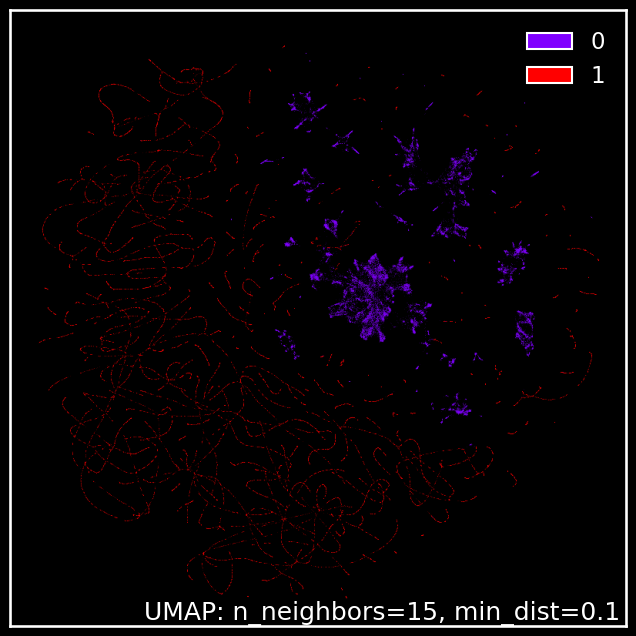

In [115]:
# SMOTE 적용후 UMAP 시각화 .
sns.set(style='ticks',context = 'talk' , font_scale =1)
plt.style.use('dark_background')
mapper = umap.UMAP().fit(df_cfd_smote.loc[:,:'Amount'])
umap.plot.points(mapper, labels=df_cfd_smote.loc[:,'Class'] , theme='fire')

## RandomOverSampler
> 교체로 샘플을 무작위로 선택하여 소수 클래스를 과도하게 샘플링하는 것을 방지합니다. 부트스트랩은 매끄러운 방식으로 생성할 수 있습니다.

In [116]:
# RandomOverSampler 적용
from imblearn.over_sampling import RandomOverSampler

ros = RandomOverSampler(random_state = 0)

X_train_ros , y_train_ros = ros.fit_resample(X_train , y_train)

print('Feature/label dataset for training before applying RandomOverSampler: ', X_train.shape, y_train.shape)
print('Feature/label dataset for training after applying RandomOverSampler: ', X_train_ros.shape, y_train_ros.shape)
print('Distribution of label values after applying RandomOverSampler: \n', pd.Series(y_train_ros).value_counts())

Feature/label dataset for training before applying RandomOverSampler:  (35000, 29) (35000,)
Feature/label dataset for training after applying RandomOverSampler:  (69884, 29) (69884,)
Distribution of label values after applying RandomOverSampler: 
 0    34942
1    34942
Name: Class, dtype: int64


Plotting histogram Plot

In [117]:
# RandomOverSampler 적용후 클래스 분포 확인
df_cfd_ros = pd.concat([X_train_ros , y_train_ros],axis = 1)
fig = px.histogram(df_cfd_ros, x="V14", 
                   color="Class", 
                   marginal="box",
                   barmode ="overlay",
                   histnorm ='density'
                  )  
fig.update_layout(
    title_text="Oversampled by RandomOverSampler",
    title_font_color="white",
    legend_title_font_color="yellow",
    paper_bgcolor="black",
    plot_bgcolor='black',
    font_color="white",
)
fig.show()


Observation:

- Fraud 의 분포도 원래 분포의 모양을 유사하게 유지하는 것을 볼 수 있습니다.

Plotting Scatter Plot

In [118]:
fig = px.scatter(df_cfd_ros, x="V17", y="V14", color="Class")
fig.update_layout(
    title_text="Oversampled by RandomOverSampler",
    title_font_color="white",
    legend_title_font_color="yellow",
    paper_bgcolor="black",
    plot_bgcolor='black',
    font_color="white",
)

Observation:

- It can be seen that the negative values increase randomly.

Visualizing after Dimension Reduction

<Axes: >

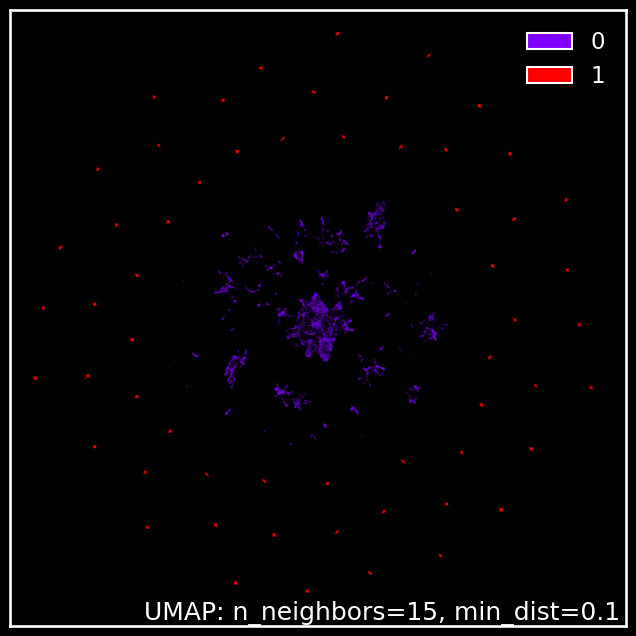

In [119]:
mapper = umap.UMAP().fit(df_cfd_ros.loc[:,:'Amount']) 
umap.plot.points(mapper, labels=df_cfd_ros.loc[:,'Class'], theme='fire')

## ADASYN
 - 이 방법은 SMOTE와 유사하지만 오버샘플링할 클래스의 로컬 분포 추정치에 따라 다른 수의 샘플을 생성합니다.

In [120]:
# ADASYN 오버샘플링
from imblearn.over_sampling import ADASYN
adasyn = ADASYN(random_state = 0)

X_train_adasyn, y_train_adasyn = adasyn.fit_resample(X_train, y_train)
print('Feature/label dataset for training before applying ADASYN: ', X_train.shape, y_train.shape)
print('Feature/label dataset for training after applying ADASYN: ', X_train_adasyn.shape, y_train_adasyn.shape)
print('Distribution of label values after applying ADASYN: \n', pd.Series(y_train_adasyn).value_counts())

Feature/label dataset for training before applying ADASYN:  (35000, 29) (35000,)
Feature/label dataset for training after applying ADASYN:  (69880, 29) (69880,)
Distribution of label values after applying ADASYN: 
 0    34942
1    34938
Name: Class, dtype: int64


Plotting histogram Plot

In [121]:
df_cfd_adasyn = pd.concat([X_train_adasyn,y_train_adasyn],axis=1)
fig = px.histogram(df_cfd_adasyn, x="V14", 
                   color="Class", 
                   marginal="box",
                   barmode ="overlay",
                   histnorm ='density'
                  )  
fig.update_layout(
    title_text="Oversampled by ADASYN",
    title_font_color="white",
    legend_title_font_color="yellow",
    paper_bgcolor="black",
    plot_bgcolor='black',
    font_color="white",
)
fig.show()

Observation:

- 히스토그램을 보면, 두 V14 feature 모두 정상 데이터(value = 0)를 증가시키는 것을 확인할 수 있습니다. 두 V14 특징 모두 사기(value = 1)와 정상(value = 0) 사이의 중복 구간이 다른 방법보다 큰 것을 확인할 수 있습니다

Plotting Scatter Plot

In [122]:
fig = px.scatter(df_cfd_adasyn, x="V17", y="V14", color="Class")
fig.update_layout(
    title_text="Oversampled by ADASYN",
    title_font_color="white",
    legend_title_font_color="yellow",
    paper_bgcolor="black",
    plot_bgcolor='black',
    font_color="white",
)

Observation:

Similar to SMOTE, it can be confirmed that oversampling occurs through interpolation.

Visualizing after Dimension Reduction

<Axes: >

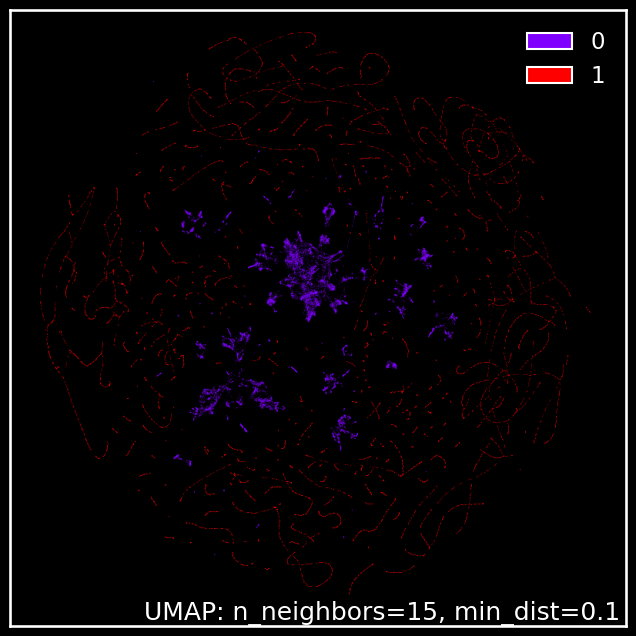

In [123]:
mapper = umap.UMAP().fit(df_cfd_adasyn.loc[:,:'Amount']) 
umap.plot.points(mapper, labels=df_cfd_adasyn.loc[:,'Class'], theme='fire')

# Undersampling

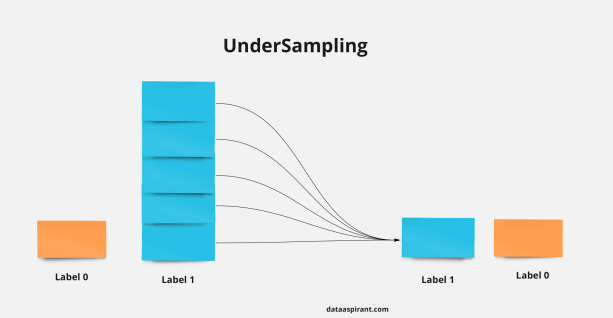

## RandomUnderSampler

- 교체 여부에 관계없이 무작위로 샘플을 선택하여 과반수 클래스를 과소 표본화합니다.

In [124]:
# RandomUnderSampler  적용

from imblearn.under_sampling import RandomUnderSampler
rus = RandomUnderSampler(random_state=0)

X_train_rus, y_train_rus = rus.fit_resample(X_train, y_train)
print('Feature/label dataset for training before applying RandomUnderSampler: ', X_train.shape, y_train.shape)
print('Feature/label dataset for training after applying RandomUnderSampler: ', X_train_rus.shape, y_train_rus.shape)
print('Distribution of label values ​​after applying RandomUnderSampler: \n', pd.Series(y_train_rus).value_counts())

Feature/label dataset for training before applying RandomUnderSampler:  (35000, 29) (35000,)
Feature/label dataset for training after applying RandomUnderSampler:  (116, 29) (116,)
Distribution of label values ​​after applying RandomUnderSampler: 
 0    58
1    58
Name: Class, dtype: int64


Observation:

- It feels like a lot of the values of the normal class(value = 0) was thrown away.

Plotting histogram Plot


In [125]:
df_cfd_rus = pd.concat([X_train_rus,y_train_rus],axis=1)
fig = px.histogram(df_cfd_rus, x="V14", 
                   color="Class", 
                   marginal="box",
                   barmode ="overlay",
                   histnorm ='density'
                  )  
fig.update_layout(
    title_text="Undersampled by RandomUnderSampler",
    title_font_color="white",
    legend_title_font_color="yellow",
    paper_bgcolor="black",
    plot_bgcolor='black',
    font_color="white",
)
fig.show()

Observation:

- Normal 클래스(값 = 0)의 데이터 수가 줄어든 것을 볼 수 있습니다. Normal 클래스(값 = 0)의 분포는 원래 분포의 모양을 유사하게 유지하는 것을 볼 수 있습니다.

Plotting Scatter Plot

In [126]:
fig = px.scatter(df_cfd_rus, x="V17", y="V14", color="Class")
fig.update_layout(
    title_text="Undersampled by RandomUnderSampler",
    title_font_color="white",
    legend_title_font_color="yellow",
    paper_bgcolor="black",
    plot_bgcolor='black',
    font_color="white",
)

Observation:

- Fraud 데이터가 무작위로 샘플링된 것을 확인할 수 있습니다. 양수 값의 분포도 변경되었습니다.

Visualizing after Dimension Reduction


<Axes: >

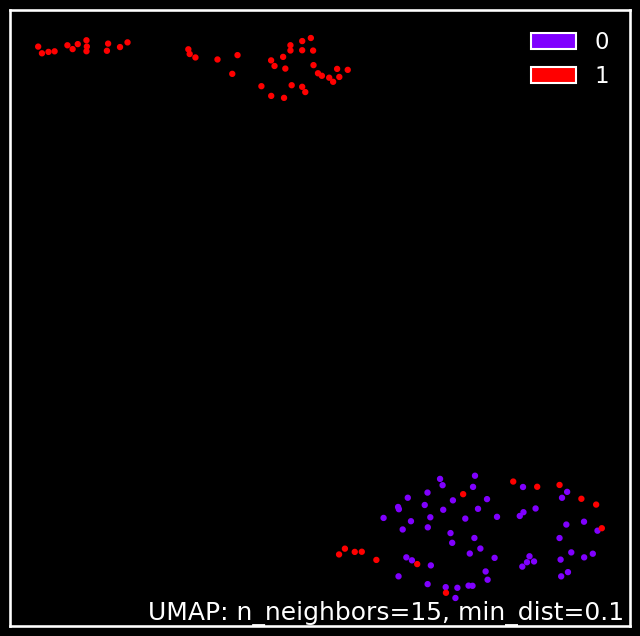

In [127]:
mapper = umap.UMAP().fit(df_cfd_rus.loc[:,:'Amount']) 
umap.plot.points(mapper, labels=df_cfd_rus.loc[:,'Class'], theme='fire')

## Instance Hardness Threshold

> 다른 방법과 달리 거리를 정의하여 분류하는 방식이 아니라 , 분류 모델을 기반으로 언더샘플링하는 방식입니다. 이상값 등 모델의 분류가 어려워질 확률을 계산하여 제거합니다. 분류 알고리즘을 결정하고 각 데이터 값에 대한 오분류 확률을 계산하여 오분류 확률이 높은 값을 제거하는 방식입니다.

In [128]:
from sklearn.linear_model import LogisticRegression
from imblearn.under_sampling import InstanceHardnessThreshold
# 'lbfgs' 0.22ver 부터 지원 , 메모리 공간 절약 , 병렬처리 지원.
iht = InstanceHardnessThreshold(random_state=0 , estimator = LogisticRegression(solver ='lbfgs' , multi_class='auto'))

X_train_iht, y_train_iht = iht.fit_resample(X_train.loc[:,features], y_train)
print('Feature/label dataset for training before applying InstanceHardnessThreshold: ', X_train.shape, y_train.shape)
print('Feature/label dataset for training after applying InstanceHardnessThreshold: ', X_train_iht.shape, y_train_iht.shape)
print('Distribution of label values after applying InstanceHardnessThreshold: \n', pd.Series(y_train_iht).value_counts())

Feature/label dataset for training before applying InstanceHardnessThreshold:  (35000, 29) (35000,)
Feature/label dataset for training after applying InstanceHardnessThreshold:  (116, 8) (116,)
Distribution of label values after applying InstanceHardnessThreshold: 
 0    58
1    58
Name: Class, dtype: int64


Plotting histogram Plot


In [129]:
df_cfd_iht = pd.concat([X_train_iht , y_train_iht],axis =1)
fig = px.histogram(df_cfd_iht , x='V14',
                   color = 'Class',
                   marginal = 'box',
                   barmode = 'overlay',
                   histnorm = 'density')
fig.update_layout(
    title_text="Undersampled by Instance Hardness Threshold",
    title_font_color="white",
    legend_title_font_color="yellow",
    paper_bgcolor="black",
    plot_bgcolor='black',
    font_color="white",
)
fig.show()

Observation:

Noraml 클래스(값=0)의 데이터 수가 줄어든 것을 확인할 수 있습니다. Normal 클래스(값=0)의 분포는 원래 분포의 형태를 유사하게 유지하는 것을 확인할 수 있으며, Fraud 클래스(값=1)의 분포는 무작위 언더샘플링에 비해 분산이 작아지는 것을 확인할 수 있습니다.

Plotting Scatter Plot


In [130]:
fig=  px.scatter(df_cfd_iht , x='V17' , y = 'V14' , color = 'Class')
fig.update_layout(
    title_text="Undersampled by RandomUnderSampler",
    title_font_color="white",
    legend_title_font_color="yellow",
    paper_bgcolor="black",
    plot_bgcolor='black',
    font_color="white",
)

Visualizing after Dimension Reduction

<Axes: >

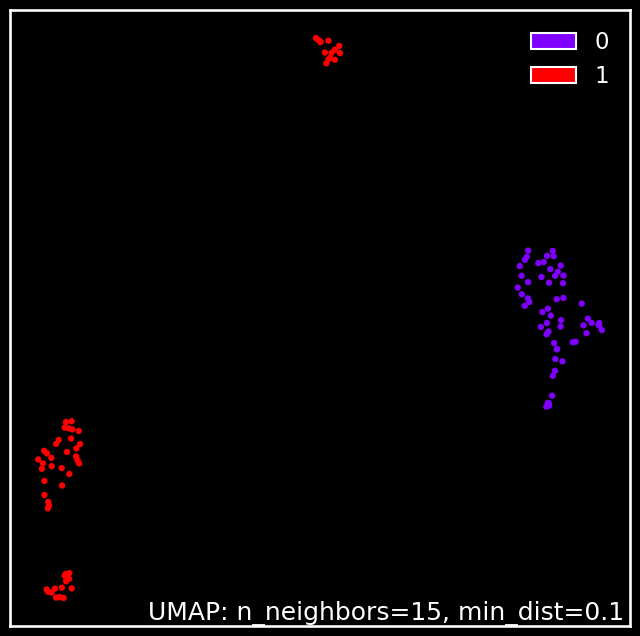

In [131]:
mapper = umap.UMAP().fit(df_cfd_iht.loc[:,:'V17'])
umap.plot.points(mapper , labels = df_cfd_iht.loc[:,'Class'],theme ='fire')

##Near Miss

- 언더샘플링 알고리즘에 따라 그룹화할 수 있으며 데이터의 균형을 맞추는 효율적인 방법입니다. 이 알고리즘은 클래스 분포를 살펴보고 더 큰 클래스에서 무작위로 샘플을 제거하여 이를 수행합니다. 서로 다른 클래스에 속하는 두 지점이 분포에서 서로 매우 가까운 경우, 이 알고리즘은 더 큰 클래스의 데이터 지점을 제거하여 분포의 균형을 맞추려고 합니다.


In [132]:
from imblearn.under_sampling import NearMiss
nm = NearMiss()

X_train_nm , y_train_nm  = nm.fit_resample(X_train , y_train)
print('Feature/label dataset for training before applying RandomUnderSampler: ', X_train.shape, y_train.shape)
print('Feature/label dataset for training after applying RandomUnderSampler: ', X_train_nm.shape, y_train_nm.shape)
print('Distribution of label values after applying RandomUnderSampler: \n', pd.Series(y_train_nm).value_counts())

Feature/label dataset for training before applying RandomUnderSampler:  (35000, 29) (35000,)
Feature/label dataset for training after applying RandomUnderSampler:  (116, 29) (116,)
Distribution of label values after applying RandomUnderSampler: 
 0    58
1    58
Name: Class, dtype: int64


Plotting histogram Plot

In [133]:
df_cfd_nm = pd.concat([X_train_nm , y_train_nm], axis = 1)

fig = px.histogram(df_cfd_nm, x="V14", 
                   color="Class", 
                   marginal="box",
                   barmode ="overlay",
                   histnorm ='density'
                  )  
fig.update_layout(
    title_text="Undersampled by Near Miss",
    title_font_color="white",
    legend_title_font_color="yellow",
    paper_bgcolor="black",
    plot_bgcolor='black',
    font_color="white",
)
fig.show()

Observation:

Normal 클래스(값 = 0)의 데이터 수가 줄어든 것을 볼 수 있습니다. Normal 클래스(값=0)의 분포가 원래 분포의 모양을 가진 이항 분포가 되었습니다. 원래 분포의 모양이 깨져 학습에 도움이 되지 않을 가능성이 높습니다.

Visualizing after Dimension Reduction

<Axes: >

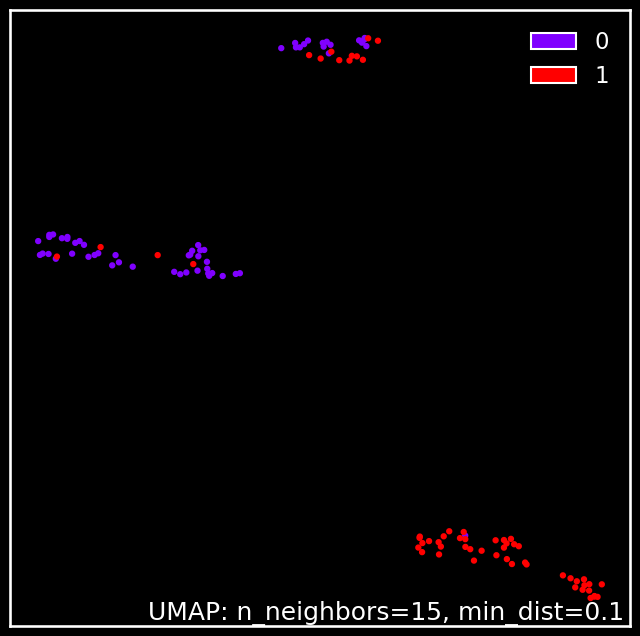

In [134]:
mapper = umap.UMAP().fit(df_cfd_nm.loc[:,:'Amount']) 
umap.plot.points(mapper, labels=df_cfd_nm.loc[:,'Class'], theme='fire')

# Let's find Fraud


## Selecting Sampling Method

- 위와 같이 신용카드 사기 데이터셋을 이용하여 오버샘플링/언더샘플링 방법을 확인했습니다. 향후 추가적인 실험이 필요하겠지만, 주요 특징의 히스토그램을 보면 오버샘플링 방법 중 SMOTE를 사용하는 것이 적절할 것으로 보입니다.

In [135]:
df_train = pd.concat([X_train_smote , y_train_smote], axis = 1)
X_test_smote , y_test_smote = smote.fit_resample(X_test , y_test)

In [136]:
colors = ['gold', 'mediumturquoise']
labels = ['Normal','Fraud']

value = df_train['Class'].value_counts()/df_train['Class'].shape[0]
fig = go.Figure(data = [go.Pie(labels= labels, values=value, hole = .3)])
fig.update_traces(hoverinfo='label+percent', textinfo='percent', textfont_size=20,
                  marker=dict(colors=colors, line=dict(color='#000000', width=2)))

fig.update_layout(
    title_text="Credit Card Fraud",
    title_font_color="white",
    legend_title_font_color="yellow",
    paper_bgcolor="black",
    plot_bgcolor='black',
    font_color="white",
)
fig.show()

Observation:

Wow! Oversampling completely solved the imbalace problem.

## Setting Up

- 이 기능은 훈련 환경을 초기화하고 변환 파이프라인을 생성합니다. 다른 함수를 실행하기 전에 설정 함수를 호출해야 합니다. 데이터와 대상이라는 두 가지 필수 매개변수가 필요합니다. 다른 모든 매개변수는 선택 사항입니다.

- Ref: https://pycaret.readthedocs.io/en/latest/api/classification.html

- tutorial : https://colab.research.google.com/github/pycaret/pycaret/blob/master/tutorials/Tutorial%20-%20Multiclass%20Classification.ipynb#scrollTo=65a19df4

In [137]:
import pycaret
# pycarat pipeline 셋업
classifier = setup(data=df_train, preprocess = False , target ='Class' , session_id = 123)

# 원본과 다른 형태로 출력되는데 , 체크 해봐야겠다.

,Description,Value
0,Session id,123
1,Target,Class
2,Target type,Binary
3,Original data shape,"(69884, 30)"
4,Transformed data shape,"(69884, 30)"
5,Transformed train set shape,"(48918, 30)"
6,Transformed test set shape,"(20966, 30)"
7,Numeric features,29


## Creating Model

- create_model은 PyCaret에서 가장 세분화된 기능이며 대부분의 PyCaret 기능의 기반이 되는 경우가 많습니다. 이름에서 알 수 있듯이 이 함수는 fold 파라미터로 설정할 수 있는 교차 검증을 사용하여 모델을 훈련하고 평가합니다. 출력은 정확도, AUC, 리콜, 정밀도, F1, 카파 및 MCC를 폴드별로 표시하는 점수 그리드를 인쇄합니다.

In [138]:
dt = create_model('dt')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,0.9988,0.9988,0.9980,0.9996,0.9988,0.9975,0.9975
1,0.9982,0.9982,0.9992,0.9971,0.9982,0.9963,0.9963
2,0.9963,0.9963,0.9971,0.9955,0.9963,0.9926,0.9926
3,0.9986,0.9986,0.9992,0.9980,0.9986,0.9971,0.9971
4,0.9982,0.9982,0.9996,0.9967,0.9982,0.9963,0.9963
5,0.9984,0.9984,0.9988,0.9980,0.9984,0.9967,0.9967
6,0.9986,0.9986,1.0000,0.9971,0.9986,0.9971,0.9971
7,0.9990,0.9990,1.0000,0.9980,0.9990,0.9980,0.9980
8,0.9982,0.9982,0.9980,0.9984,0.9982,0.9963,0.9963


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

In [139]:
# baseline 모델 비교 
best = compare_models()

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,TT (Sec)
rf,Random Forest Classifier,0.9999,1.0000,1.0000,0.9998,0.9999,0.9998,0.9998,14.9810
et,Extra Trees Classifier,0.9999,1.0000,1.0000,0.9998,0.9999,0.9998,0.9998,2.7390
xgboost,Extreme Gradient Boosting,0.9997,1.0000,1.0000,0.9993,0.9997,0.9993,0.9993,16.2540
lightgbm,Light Gradient Boosting Machine,0.9997,1.0000,1.0000,0.9994,0.9997,0.9994,0.9994,1.3790
knn,K Neighbors Classifier,0.9987,0.9995,1.0000,0.9974,0.9987,0.9974,0.9974,3.0300
dt,Decision Tree Classifier,0.9982,0.9982,0.9990,0.9974,0.9982,0.9964,0.9964,0.0810
gbc,Gradient Boosting Classifier,0.9981,0.9999,1.0000,0.9962,0.9981,0.9962,0.9962,43.7100
ada,Ada Boost Classifier,0.9968,0.9997,0.9989,0.9946,0.9968,0.9935,0.9936,8.9210
lr,Logistic Regression,0.9890,0.9980,1.0000,0.9784,0.9891,0.9779,0.9782,0.7490
svm,SVM - Linear Kernel,0.9885,0.0000,1.0000,0.9776,0.9887,0.9771,0.9773,0.2320


Processing:   0%|          | 0/65 [00:00<?, ?it/s]

In [140]:
dt = create_model('dt')
qda = create_model('qda')
lgbm = create_model('lightgbm')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,0.9988,0.9988,0.9980,0.9996,0.9988,0.9975,0.9975
1,0.9982,0.9982,0.9992,0.9971,0.9982,0.9963,0.9963
2,0.9963,0.9963,0.9971,0.9955,0.9963,0.9926,0.9926
3,0.9986,0.9986,0.9992,0.9980,0.9986,0.9971,0.9971
4,0.9982,0.9982,0.9996,0.9967,0.9982,0.9963,0.9963
5,0.9984,0.9984,0.9988,0.9980,0.9984,0.9967,0.9967
6,0.9986,0.9986,1.0000,0.9971,0.9986,0.9971,0.9971
7,0.9990,0.9990,1.0000,0.9980,0.9990,0.9980,0.9980
8,0.9982,0.9982,0.9980,0.9984,0.9982,0.9963,0.9963


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,0.9618,0.9983,1.0000,0.9290,0.9632,0.9235,0.9263
1,0.9702,0.9981,1.0000,0.9437,0.9710,0.9403,0.9420
2,0.9702,0.9991,1.0000,0.9437,0.9710,0.9403,0.9420
3,0.9681,0.9985,1.0000,0.9400,0.9691,0.9362,0.9381
4,0.9601,0.9974,1.0000,0.9262,0.9617,0.9203,0.9232
5,0.9650,0.9974,1.0000,0.9347,0.9662,0.9301,0.9324
6,0.9655,0.9979,1.0000,0.9354,0.9666,0.9309,0.9331
7,0.9628,0.9980,1.0000,0.9307,0.9641,0.9256,0.9282
8,0.9632,0.9980,1.0000,0.9314,0.9645,0.9264,0.9289


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,0.9998,1.0000,1.0000,0.9996,0.9998,0.9996,0.9996
1,0.9992,0.9998,1.0000,0.9984,0.9992,0.9984,0.9984
2,0.9998,1.0000,1.0000,0.9996,0.9998,0.9996,0.9996
3,0.9998,1.0000,1.0000,0.9996,0.9998,0.9996,0.9996
4,0.9998,1.0000,1.0000,0.9996,0.9998,0.9996,0.9996
5,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
6,0.9994,1.0000,1.0000,0.9988,0.9994,0.9988,0.9988
7,0.9998,1.0000,1.0000,0.9996,0.9998,0.9996,0.9996
8,0.9998,1.0000,1.0000,0.9996,0.9998,0.9996,0.9996


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

## Tuning Hyperparameters
- create_model() 함수를 사용하여 모델을 생성하면 기본 하이퍼파라미터를 사용하여 모델을 학습시킵니다. 하이퍼파라미터를 조정하기 위해 tune_model() 함수가 사용됩니다. 이 함수는 사전 정의된 검색 공간에서 무작위 그리드 검색을 사용하여 모델의 하이퍼파라미터를 자동으로 튜닝합니다. 출력에는 최상의 모델에 대한 정확도, AUC, 리콜, 정밀도, F1, 카파 및 MCC를 배율별로 표시하는 점수 그리드가 인쇄됩니다. 사용자 정의 검색 그리드를 사용하려면 tune_model 함수에 custom_grid 매개 변수를 전달하면 됩니다.

In [141]:
tuned_dt  = tune_model(dt, optimize='Recall')
tuned_qda  = tune_model(qda, optimize='Recall')
tuned_lgbm  = tune_model(lgbm, optimize='Recall')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,0.9978,0.9984,0.9988,0.9967,0.9978,0.9955,0.9955
1,0.9980,0.9987,0.9984,0.9975,0.9980,0.9959,0.9959
2,0.9959,0.9979,0.9947,0.9971,0.9959,0.9918,0.9918
3,0.9973,0.9982,0.9980,0.9967,0.9973,0.9947,0.9947
4,0.9975,0.9983,0.9980,0.9971,0.9975,0.9951,0.9951
5,0.9963,0.9972,0.9963,0.9963,0.9963,0.9926,0.9926
6,0.9959,0.9967,0.9955,0.9963,0.9959,0.9918,0.9918
7,0.9963,0.9978,0.9967,0.9959,0.9963,0.9926,0.9926
8,0.9969,0.9982,0.9971,0.9967,0.9969,0.9939,0.9939


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 10 candidates, totalling 100 fits


Original model was better than the tuned model, hence it will be returned. NOTE: The display metrics are for the tuned model (not the original one).


,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,0.9720,0.9948,0.9652,0.9785,0.9718,0.9440,0.9441
1,0.9669,0.9942,0.9591,0.9743,0.9666,0.9338,0.9339
2,0.9722,0.9967,0.9612,0.9829,0.9719,0.9444,0.9446
3,0.9710,0.9949,0.9652,0.9764,0.9708,0.9419,0.9420
4,0.9667,0.9945,0.9583,0.9746,0.9664,0.9334,0.9335
5,0.9710,0.9947,0.9636,0.9780,0.9708,0.9419,0.9420
6,0.9667,0.9946,0.9563,0.9766,0.9663,0.9334,0.9336
7,0.9749,0.9955,0.9734,0.9762,0.9748,0.9497,0.9497
8,0.9675,0.9945,0.9591,0.9755,0.9672,0.9350,0.9351


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 10 candidates, totalling 100 fits


Original model was better than the tuned model, hence it will be returned. NOTE: The display metrics are for the tuned model (not the original one).


,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,0.9994,1.0000,1.0000,0.9988,0.9994,0.9988,0.9988
1,0.9982,0.9998,1.0000,0.9963,0.9982,0.9963,0.9963
2,0.9996,0.9999,1.0000,0.9992,0.9996,0.9992,0.9992
3,0.9998,1.0000,1.0000,0.9996,0.9998,0.9996,0.9996
4,0.9996,1.0000,1.0000,0.9992,0.9996,0.9992,0.9992
5,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
6,0.9994,1.0000,1.0000,0.9988,0.9994,0.9988,0.9988
7,0.9990,1.0000,1.0000,0.9980,0.9990,0.9980,0.9980
8,0.9994,1.0000,1.0000,0.9988,0.9994,0.9988,0.9988


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 10 candidates, totalling 100 fits


Original model was better than the tuned model, hence it will be returned. NOTE: The display metrics are for the tuned model (not the original one).


## Interpreting Model


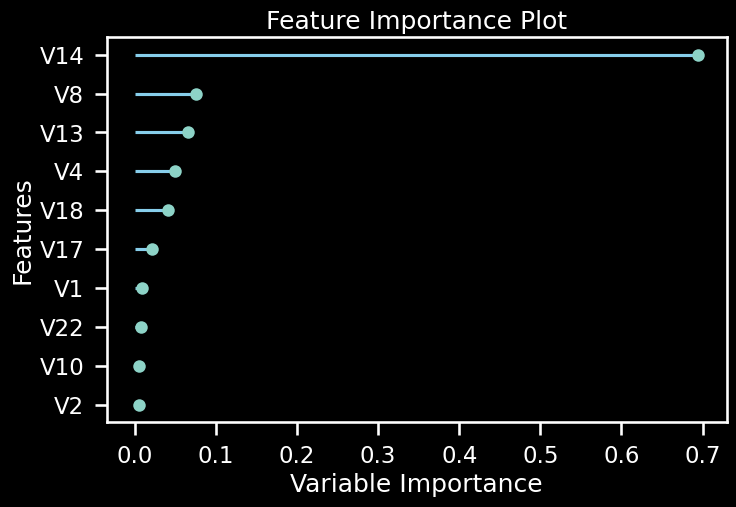

In [142]:
plot_model(tuned_dt, plot='feature')

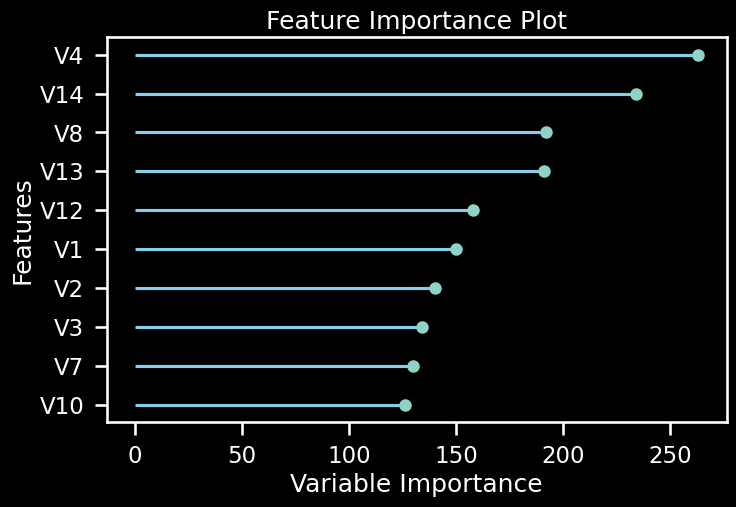

In [143]:
plot_model(tuned_lgbm, plot='feature')

##Ploting Model

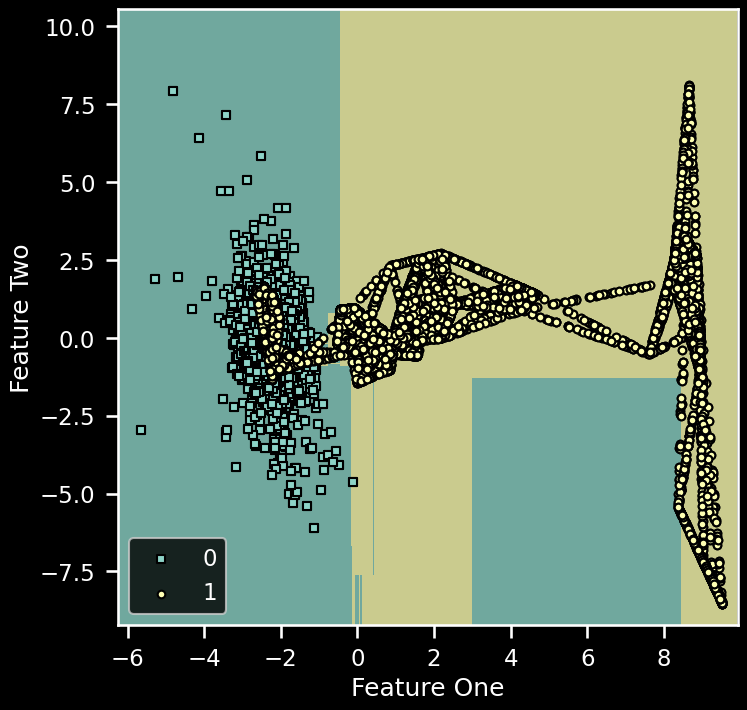

In [144]:
# LGBM 
plt.figure(figsize=(8, 8))
plot_model(tuned_lgbm, plot='boundary')

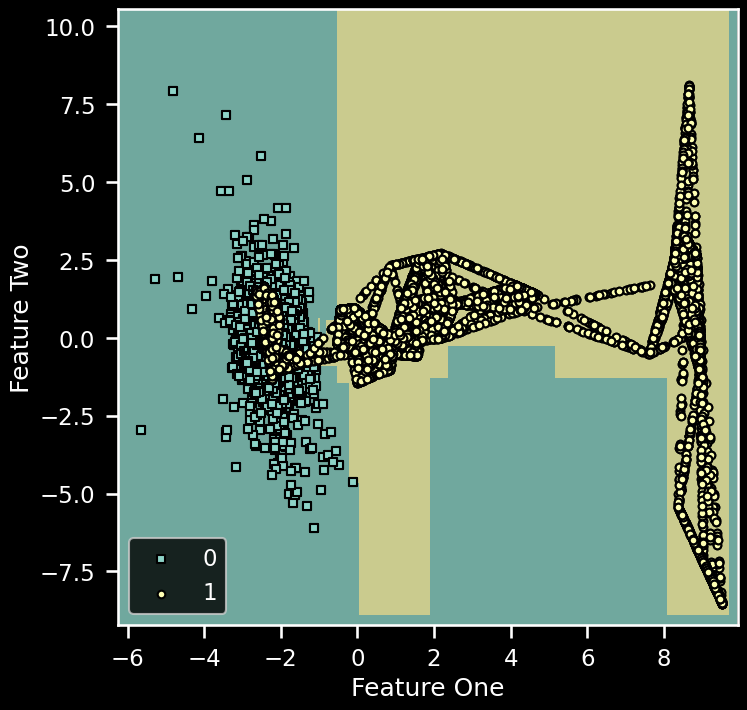

In [145]:
# Decision tree
plt.figure(figsize=(8, 8))
plot_model(tuned_dt, plot='boundary')

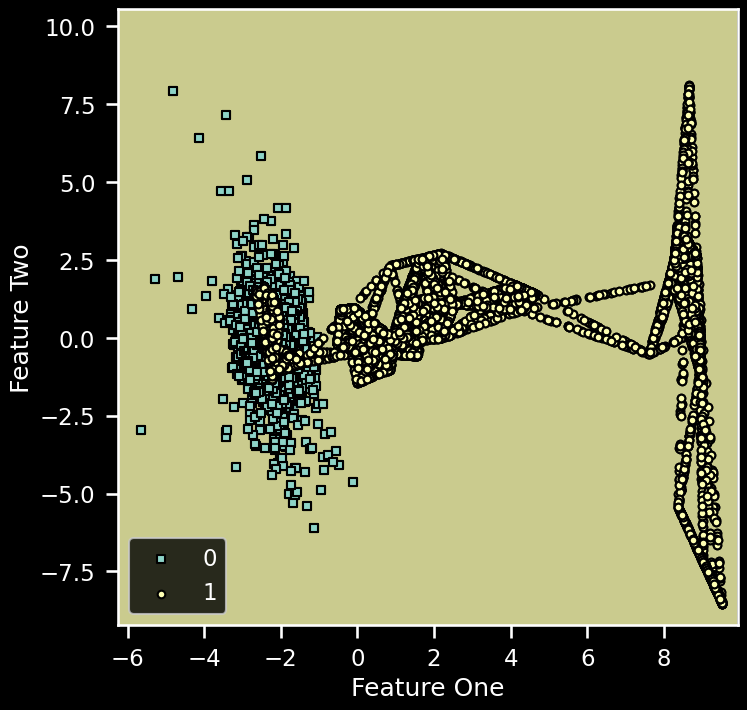

In [146]:
# QDA
plt.figure(figsize=(8, 8))
plot_model(tuned_qda, plot='boundary')

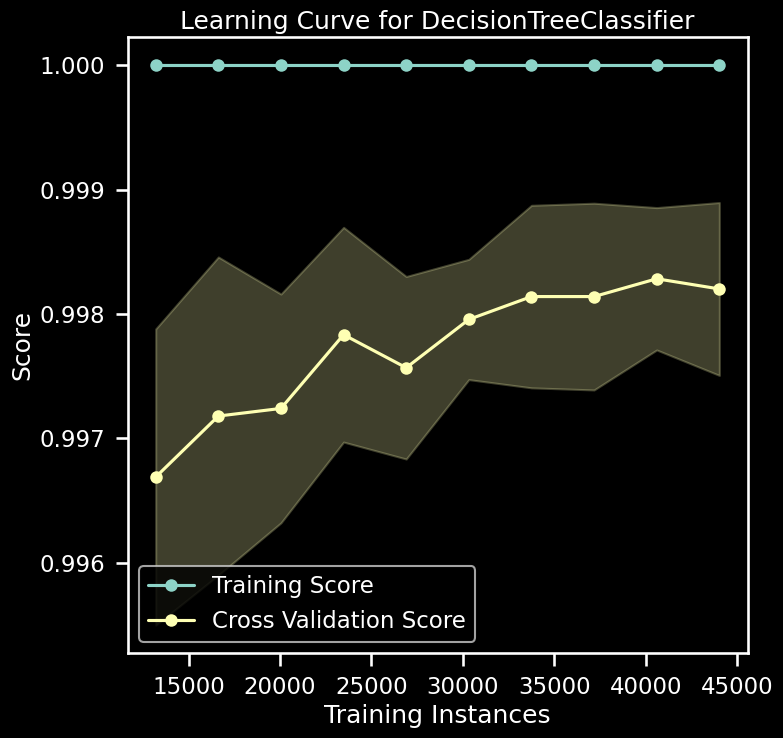

In [147]:
plt.figure(figsize=(8, 8))
plot_model(tuned_dt, plot='learning')

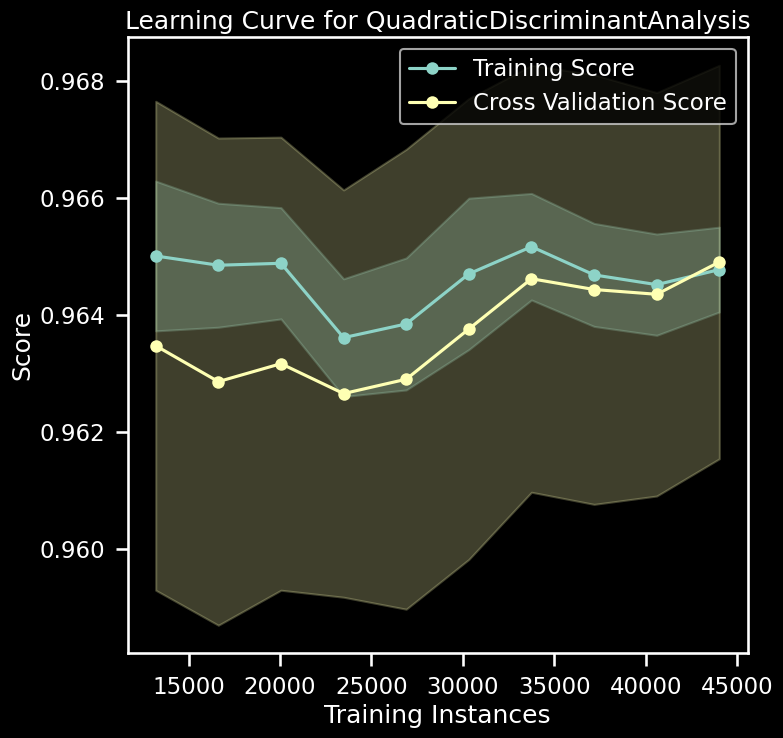

In [148]:
plt.figure(figsize=(8, 8))
plot_model(tuned_qda, plot='learning')

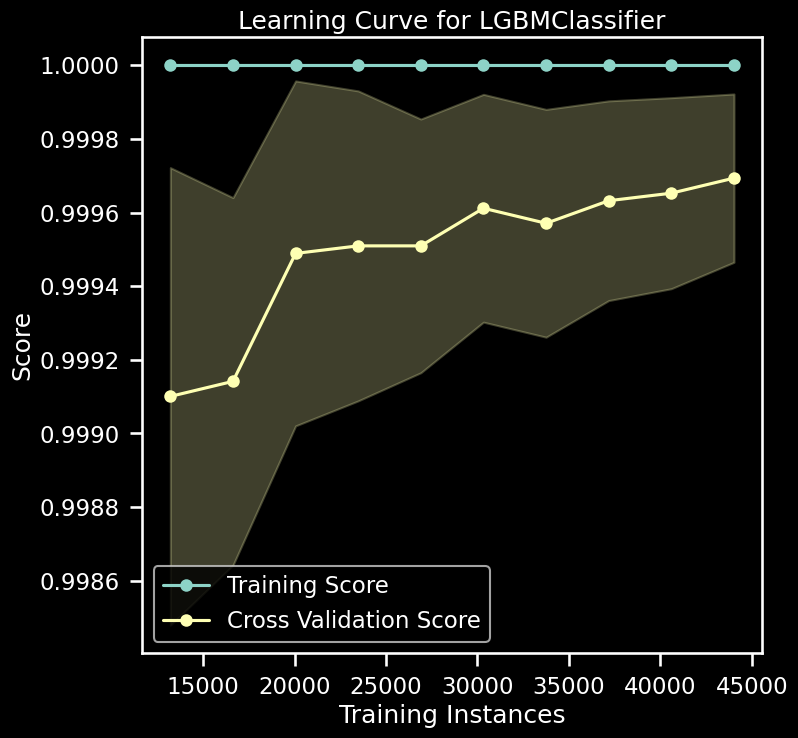

In [149]:
plt.figure(figsize=(8, 8))
plot_model(tuned_lgbm, plot='learning')

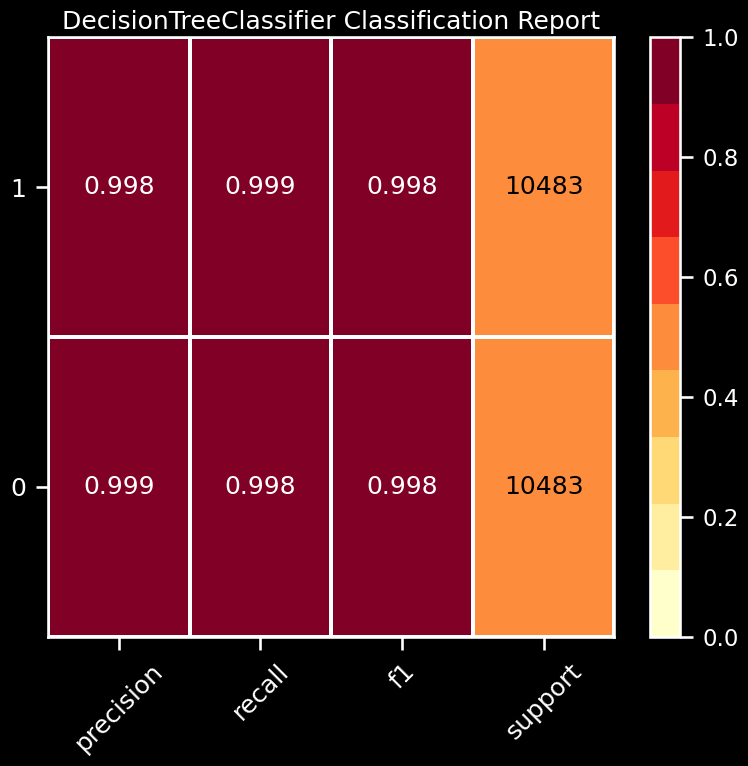

In [150]:
plt.figure(figsize=(8, 8))
plot_model(tuned_dt, plot='class_report')

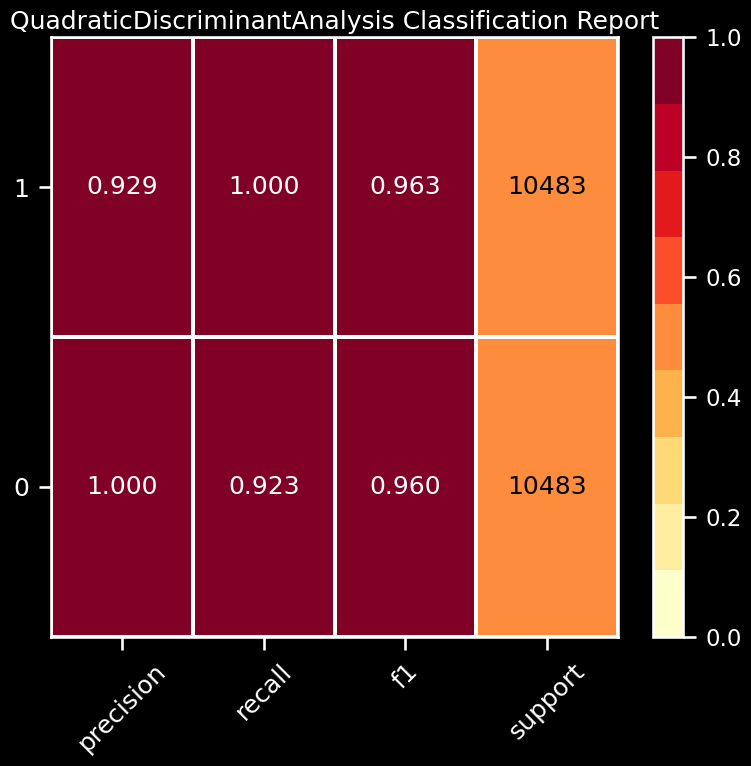

In [151]:
plt.figure(figsize=(8, 8))
plot_model(tuned_qda, plot='class_report')

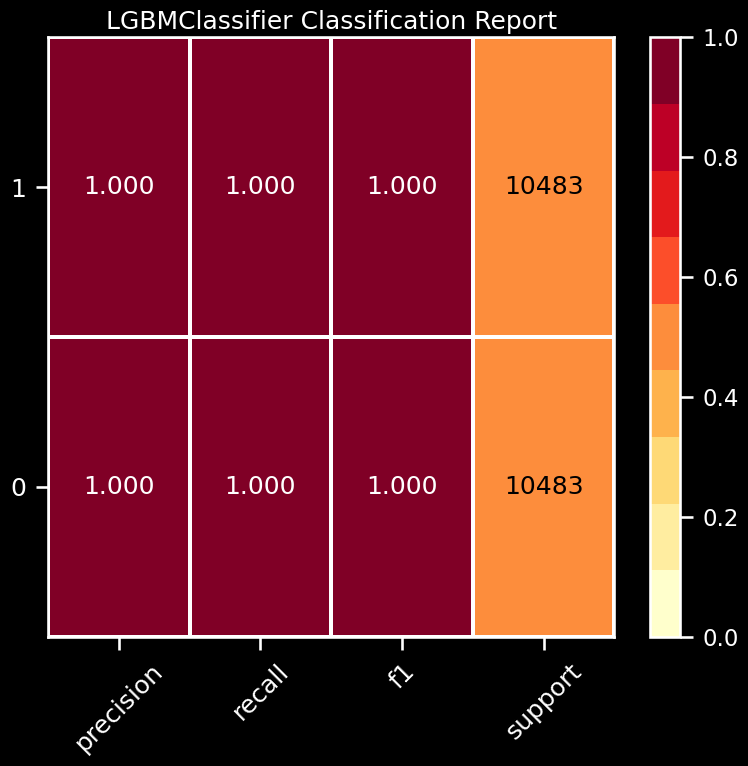

In [152]:
plt.figure(figsize=(8, 8))
plot_model(tuned_lgbm, plot='class_report')

## Predicting with the test dateset

In [153]:
#lgbm 
pred = tuned_lgbm.predict(X_test_smote)

In [154]:
final_model_result = confusion_matrix(y_test_smote, pred)
accuracy = accuracy_score(y_test_smote, pred)
precision = precision_score(y_test_smote, pred)
recall = recall_score(y_test_smote, pred)
f1 = f1_score(y_test_smote, pred)
print('accuracy: {0:.4f}, precision: {1:.4f}, recall: {2:.4f},\
F1: {3:.4f}'.format(accuracy, precision, recall, f1))

accuracy: 0.8872, precision: 0.9993, recall: 0.7750,F1: 0.8730


Text(0.5, 1.0, 'Confusion Matrix LGBM')

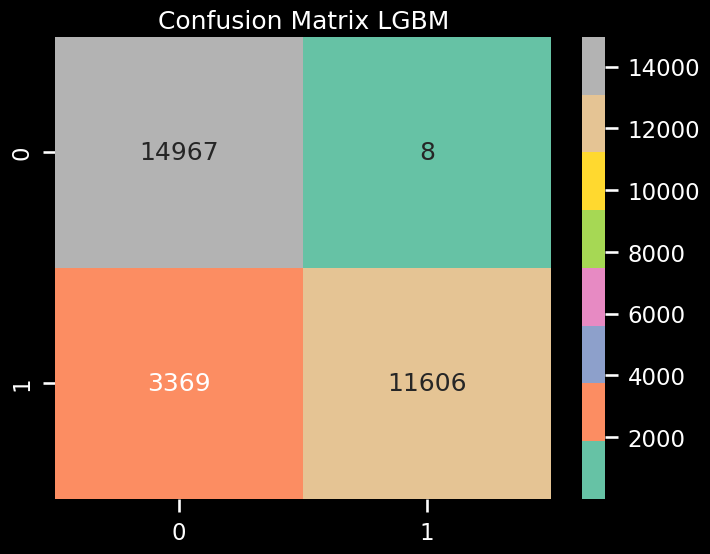

In [155]:
plt.figure(figsize=(8,6))
ax = sns.heatmap(final_model_result , cmap = 'Set2' , annot=True , fmt ='d')
ax.set_title('Confusion Matrix LGBM')

In [156]:
# 과적합의 적절한 예시 
pred_qda = tuned_qda.predict(X_test_smote)

In [157]:
final_model_result_qda = confusion_matrix(y_test_smote, pred_qda)
accuracy_qda = accuracy_score(y_test_smote, pred_qda)
precision_qda = precision_score(y_test_smote, pred_qda)
recall_qda = recall_score(y_test_smote, pred_qda)
f1_qda = f1_score(y_test_smote, pred_qda)
print('accuracy: {0:.4f}, precision: {1:.4f}, recall: {2:.4f},\
F1: {3:.4f}'.format(accuracy_qda, precision_qda, recall_qda, f1_qda))

accuracy: 0.9100, precision: 0.9215, recall: 0.8964,F1: 0.9088


Text(0.5, 1.0, 'Confusion Matrix QDA')

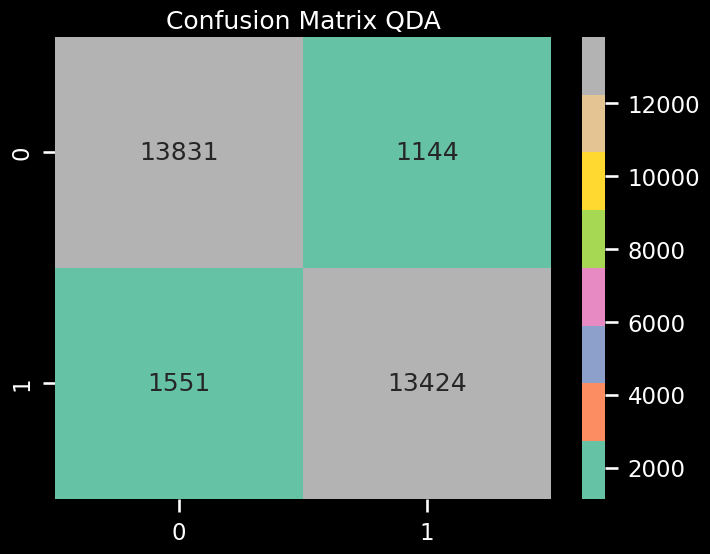

In [158]:
plt.figure(figsize=(8,6))
ax = sns.heatmap(final_model_result_qda , cmap = 'Set2' , annot=True , fmt ='d')
ax.set_title('Confusion Matrix QDA')

- 필사 소감 및 기억 해 두면 좋을 것들.
 - 불균형 데이터에 대한 샘플링 기법 , Pycaret , UMAP ( 차원축소 ) 등 평소에 얘기만 들어 봤던 내용을 직접 실습해 본 것과 , 시각화 를 통해서 분석을 확인 하는 방법등에 대해서 진행 해 본 것 같다 는 생각이 든다.

 - 샘플링 기법,Scoring , CV 들에 대해서는 Class 나 def 로 시각화 되는 부분 까지 만들어서 사용 하는 방법을 선택해서 향후에 귀찮은 일을 하지 않도록 만들어 보자.

 - Pycaet 의 경우 Funtional API 를 사용 하게 된것 같은데 , colab 에서는 에러가 자주 발생 하고 있는것 같다. 다른 자료를 참조 하니 OOP 방식으로 쓰고 있는 것 같아서 다른 데이터를 가지고 TEST 를 진행 해 볼 수 있을 것 같다. (https://pycaret.gitbook.io/docs/ )

 - Pycaret 의 경우 다양한 ML을 통합해서 볼 수 있어서 BaseLine 잡기에 적합한 방법 이지 않을 까 싶다.
 
 - 샘플이 20,000 개인 경우 QDA는 완벽하게 과적합 되어서 TEST 검증에서 Precision , Recall 에서 0 가 나왔으며 , Accuracy 에서는 50% 정도 표현되었다. 

 - QDA
  - https://godongyoung.github.io/%EB%A8%B8%EC%8B%A0%EB%9F%AC%EB%8B%9D/2018/01/23/ISL-Classification_ch4.html
  - https://24bean.tistory.com/entry/LDA-QDA-%EC%B0%A8%EC%9D%B4-%EB%B9%84%EA%B5%90

 - 다만 샘플이 50,000 개로 늘렸을때는 LGBM 보다 더 나은 수치를 보여 주고 있다. 

 - 데이터의 개수에 따른 결과 인지 , 특성(데이터 혹은 모델) 에 따른 결과인지 에 대한 것을 알기 위해서는 추후 TEST 가 필요 할 것 같다.

 - 샘플 50,000 개로 진행 했을 때 UMAP 차원축소에서 2시간 이상의 시간이 소모 되었다. 중간에 잠들어서 정확하게 어느 정도 시간이 걸렸는지는 알기가 어렵지만, 간단히 확인 하고자 한다면 20,000개 가 적합 할 것으로 판단 되지만 , QDA 결과가 다르게 나왔다는 것에서 다른 데이터 라고 할지라도 여러 테스트가 필요로 할것 같다. ( GPU 의 사용 파라미터 라든가 ).

 - 다만 , CFD에 대해서 이렇게 진행 하는게 맞는가 하는 생각이 들어서 다른 필사도 한번 더 진행 해보려고 한다. 